<a href="https://colab.research.google.com/github/divyatadimeti/speaker_diarization/blob/main/Deepgram_Speaker_Change_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Take 1: Implementing simple version of Google Speech Diarization

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cd gdrive/My\ Drive/Resemblyzer

/content/gdrive/My Drive/Resemblyzer


In [ ]:
# ! git clone https://github.com/resemble-ai/Resemblyzer.git

In [ ]:
! pip install webrtcvad-wheels

In [ ]:
! pip install webrtcvad

In [ ]:
# Resemblyzer is a package which can help with speech segmentation and embeddings
from resemblyzer import preprocess_wav, VoiceEncoder
from pathlib import Path

In [ ]:
#path to audio file, using Path module
audio_file_path = 'F_0126_6y9m_1.wav'
# audio_file_path = "praat_sample.wav"
wav_fpath = Path(audio_file_path)

In [ ]:
import IPython
IPython.display.Audio('F_0126_6y9m_1.wav')

In [ ]:
# preprocess_wav applies a VAD to audio file (get rid of silences, normalizes decibel level)
wav = preprocess_wav(wav_fpath)
# make VoiceEncoder class object
encoder = VoiceEncoder("cpu")

# embed_utterance function of this instance takes in the processed wav file,
# segments it out into windows
# makes MFCCs of these segments
# and creates d-vectors of these audio segments
_, cont_embeds, wav_splits = encoder.embed_utterance(wav, return_partials=True, rate=16)

Loaded the voice encoder model on cpu in 0.12 seconds.


In [ ]:
! pip3 install spectralcluster

In [ ]:
from spectralcluster import SpectralClusterer

clusterer = SpectralClusterer(
    min_clusters=2,
    max_clusters=100)

# cluster the d-vectors into labels
labels = clusterer.predict(cont_embeds)

In [ ]:
# join continuous windows which have the same speaker label
def create_labelling(labels,wav_splits):
    from resemblyzer import sampling_rate
    times = [((s.start + s.stop) / 2) / sampling_rate for s in wav_splits]
    labelling = []
    start_time = 0

    for i,time in enumerate(times):
        if i>0 and labels[i]!=labels[i-1]:
            temp = [str(labels[i-1]),start_time,time]
            labelling.append(tuple(temp))
            start_time = time
        if i==len(times)-1:
            temp = [str(labels[i]),start_time,time]
            labelling.append(tuple(temp))

    return labelling

labelling = create_labelling(labels,wav_splits)

In [ ]:
# list of tuples: (speaker_label, start_time, end_time)
labelling

[('0', 0, 1.04),
 ('1', 1.04, 2.72),
 ('0', 2.72, 2.96),
 ('1', 2.96, 3.02),
 ('0', 3.02, 3.14),
 ('1', 3.14, 4.64),
 ('0', 4.64, 6.44),
 ('1', 6.44, 31.94),
 ('0', 31.94, 35.3),
 ('1', 35.3, 39.38),
 ('0', 39.38, 42.98),
 ('1', 42.98, 44.06),
 ('0', 44.06, 44.36),
 ('1', 44.36, 44.78),
 ('0', 44.78, 46.82),
 ('1', 46.82, 49.94),
 ('0', 49.94, 54.5),
 ('1', 54.5, 54.62),
 ('0', 54.62, 54.8),
 ('1', 54.8, 55.1),
 ('0', 55.1, 56.42),
 ('1', 56.42, 62.66),
 ('0', 62.66, 65.54),
 ('1', 65.54, 66.56),
 ('0', 66.56, 68.12),
 ('1', 68.12, 69.86),
 ('0', 69.86, 75.14),
 ('1', 75.14, 75.44),
 ('0', 75.44, 78.68),
 ('1', 78.68, 81.02),
 ('0', 81.02, 84.86),
 ('1', 84.86, 89.12),
 ('0', 89.12, 91.76),
 ('1', 91.76, 92.84),
 ('0', 92.84, 94.34),
 ('1', 94.34, 95.18),
 ('0', 95.18, 97.16),
 ('1', 97.16, 98.66),
 ('0', 98.66, 102.56),
 ('1', 102.56, 107.9),
 ('0', 107.9, 109.1),
 ('1', 109.1, 109.28),
 ('0', 109.28, 109.52),
 ('1', 109.52, 113.3),
 ('0', 113.3, 119.66),
 ('1', 119.66, 119.78),
 ('0'

In [ ]:
IPython.display.Audio('F_0126_6y9m_1.wav')

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
s1_segments = []
s2_segments = []

for tup in labelling:
  seg = (tup[1], tup[2])
  if tup[0] == '0':
    s1_segments.append(seg)
  else:
    s2_segments.append(seg)

speaker_list = []
for tup in labelling:
  speaker_list.append(tup[0])
s2_segments.pop(0)


# s1_segments

(1.04, 2.72)

In [ ]:
import altair as alt
import datetime as dt
import pandas as pd


alt.renderers.enable('jupyterlab')
alt.renderers.enable('default')

data = pd.DataFrame()
data['from(s)'] = [t[1] for t in labelling]
data['to(s)'] = [t[2] for t in labelling]
data['speaker'] = speaker_list
#data

chart = alt.Chart(data).mark_bar().encode(
    x='from(s)',
    x2='to(s)',
    y='speaker',
    color=alt.Color('speaker', scale=alt.Scale(scheme='dark2'))
)
chart

alt.Chart(...)

# Take 2: Using Parselmouth for Pitch

Idea: Different speakers have a different fundamental frequency.


In [ ]:
pip install praat-parselmouth

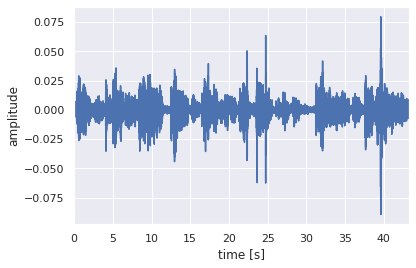

In [ ]:
import parselmouth
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set() # seaborn's default style

# praat_sample.wav is a ~20 second clip of the above clip
# snd = parselmouth.Sound("praat_sample.wav")
# snd = parselmouth.Sound("M_0398_12y5m_1.wav")
snd = parselmouth.Sound("meeting_multivoice.wav")
plt.figure()
plt.plot(snd.xs(), snd.values.T)
plt.xlim([snd.xmin, snd.xmax])
plt.xlabel("time [s]")
plt.ylabel("amplitude")
plt.show()

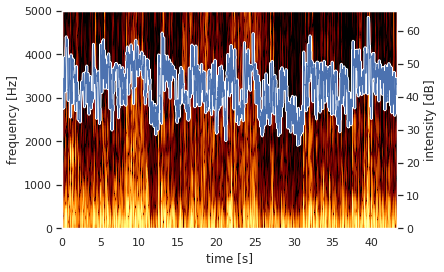

In [ ]:
def draw_spectrogram(spectrogram, dynamic_range=70):
    X, Y = spectrogram.x_grid(), spectrogram.y_grid()
    sg_db = 10 * np.log10(spectrogram.values)
    plt.pcolormesh(X, Y, sg_db, vmin=sg_db.max() - dynamic_range, cmap='afmhot')
    plt.ylim([spectrogram.ymin, spectrogram.ymax])
    plt.xlabel("time [s]")
    plt.ylabel("frequency [Hz]")

def draw_intensity(intensity):
    plt.plot(intensity.xs(), intensity.values.T, linewidth=3, color='w')
    plt.plot(intensity.xs(), intensity.values.T, linewidth=1)
    plt.grid(False)
    plt.ylim(0)
    plt.ylabel("intensity [dB]")

intensity = snd.to_intensity()
spectrogram = snd.to_spectrogram()
plt.figure()
draw_spectrogram(spectrogram)
plt.twinx()
draw_intensity(intensity)
plt.xlim([snd.xmin, snd.xmax])
plt.show()

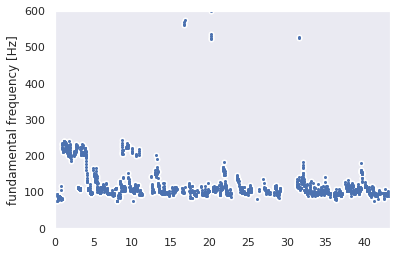

In [ ]:
def draw_pitch(pitch):
    # Extract selected pitch contour, and
    # replace unvoiced samples by NaN to not plot
    pitch_values = pitch.selected_array['frequency']
    pitch_values[pitch_values==0] = np.nan
    plt.plot(pitch.xs(), pitch_values, 'o', markersize=5, color='w')
    plt.plot(pitch.xs(), pitch_values, 'o', markersize=2)
    plt.grid(False)
    plt.ylim(0, pitch.ceiling)
    plt.ylabel("fundamental frequency [Hz]")

pitch = snd.to_pitch()
draw_pitch(pitch)
plt.xlim([snd.xmin, snd.xmax])
plt.show()

In [ ]:
pitch.xs()

array([ 0.02280045,  0.03280045,  0.04280045, ..., 19.73280045,
       19.74280045, 19.75280045])

In [ ]:
print(pitch)

Object type: Pitch
Object name: <no name>
Date: Fri Apr 29 20:30:31 2022

Time domain:
   Start time: 0 seconds
   End time: 43.2844375 seconds
   Total duration: 43.2844375 seconds
Time sampling:
   Number of frames: 4325 (2431 voiced)
   Time step: 0.01 seconds
   First frame centred at: 0.022218750000001394 seconds
Ceiling at: 600 Hz

Estimated quantiles:
   10% = 93.415341 Hz = 86.279699 Mel = -1.17922321 semitones above 100 Hz = 2.83633808 ERB
   16% = 95.0011229 Hz = 87.6335787 Mel = -0.88780235 semitones above 100 Hz = 2.87874537 ERB
   50% = 104.536701 Hz = 95.705159 Mel = 0.768114388 semitones above 100 Hz = 3.13022064 ERB
   84% = 136.674911 Hz = 122.068486 Mel = 5.40898123 semitones above 100 Hz = 3.93616528 ERB
   90% = 199.226422 Hz = 170.017627 Mel = 11.932908 semitones above 100 Hz = 5.34694948 ERB
Estimated spreading:
   84%-median = 32.14 Hz = 26.37 Mel = 4.642 semitones = 0.8061 ERB
   median-16% = 9.538 Hz = 8.073 Mel = 1.656 semitones = 0.2515 ERB
   90%-10% = 105.8

Text(0, 0.5, 'fundamental frequency (hz)')

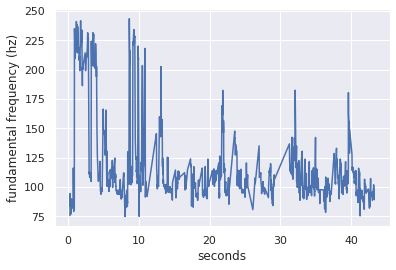

In [ ]:
pitch = snd.to_pitch()
pitch_values = pitch.selected_array['frequency']
pitch_values[pitch_values==0] = np.nan
pitch_list = pitch_values.tolist()
xs_list = pitch.xs().tolist()

voiced_pitch_list = []
pitch_xs = []
data_tups = []

# get rid of voiceless data points
# get rid of data points that are outside normal range of human voice
for i in range(len(pitch_list)):
  if (np.isnan(pitch_list[i]) == False) and pitch_list[i] < 400 and pitch_list[i] > 50:
    voiced_pitch_list.append(pitch_list[i])
    pitch_xs.append(xs_list[i])
    data_tups.append((xs_list[i], pitch_list[i]))


plt.plot(pitch_xs, voiced_pitch_list)
plt.xlabel("seconds")
plt.ylabel("fundamental frequency (hz)")



In [ ]:
import IPython
# IPython.display.Audio("praat_sample.wav")
IPython.display.Audio("meeting_multivoice.wav")

In [ ]:
# max(pitch_xs)

In [ ]:
# pitch_xs

In [ ]:
# every tenth of a second
window_width = 10
windows = []

# SLIDING WINDOW
for i in range(0, len(voiced_pitch_list)):
    windows.append(voiced_pitch_list[i:i+window_width])

# AVERAGES
avgs = []
for window in windows:
  avgs.append(np.mean(window))

# VARIANCES
vars = []
for window in windows:
  vars.append(np.var(window))

# STANDARD DEVIATIONS
stds = []
for window in windows:
  stds.append(np.std(window))

Text(0, 0.5, 'avg')

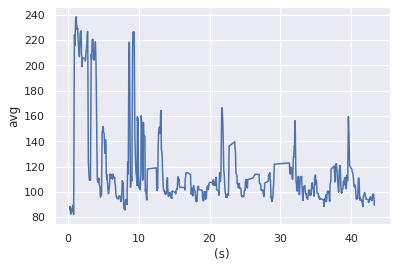

In [ ]:
# PLOT AVERAGE
plt.plot(pitch_xs, avgs)
plt.xlabel("(s)")
plt.ylabel("avg")

Text(0, 0.5, 'variance')

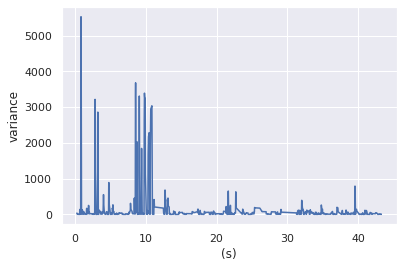

In [ ]:
# PLOT VARIANCE
plt.plot(pitch_xs, vars)
plt.xlabel("(s)")
plt.ylabel("variance")

Text(0, 0.5, 'standard deviation')

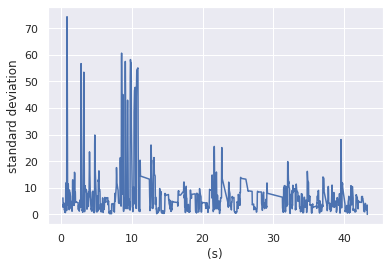

In [ ]:
# PLOT STANDARD DEVIATION
plt.plot(pitch_xs, stds)
plt.xlabel("(s)")
plt.ylabel("standard deviation")

In [ ]:
import IPython
IPython.display.Audio("praat_sample.wav")
# IPython.display.Audio("meeting_multivoice.wav")

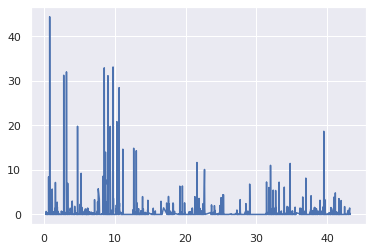

In [ ]:
# get differences between each window
differences = [y-x for x, y in zip(stds[:-1], stds[1:])]
# get largest positive jumps in differences
max_differences = [max(x,0) for x in differences]
plt.plot(pitch_xs[:-1], max_differences)

# each peak in the std is a big positive delta, indicating a new speaker

In [ ]:
# IPython.display.Audio("praat_sample.wav")
# IPython.display.Audio("M_0398_12y5m_1.wav")
IPython.display.Audio("meeting_multivoice.wav")

In [ ]:
# snd = parselmouth.Sound("praat_sample.wav")
# mfcc = snd.to_mfcc()
# print(mfcc)